# **Checkbox Recognition**

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# 1. Mount to Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# 2. Verify folder location
import os

folder_path = '/content/drive/MyDrive/Checkbox_Recognition/input'

# Verify if folder exists
if os.path.exists(folder_path):
    print("The folder was found.")
else:
    print("The folder wasn't found.")


The folder was found.


# The proposed method

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd

# ============================
# 1. Load and Prepare Image List
# ============================

# Get all image filenames from the folder
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Create the output folder if it doesn't exist
output_folder = '/content/drive/MyDrive/Checkbox_Recognition/output'
os.makedirs(output_folder, exist_ok=True)

# Minimum area threshold to filter out small noisy contours
min_area_threshold = 1000

# Global list to collect results from all images
all_results = []

# ============================
# 2. Process Each Image
# ============================

for img_name in image_files:
    # Load and upscale the image to enhance small details
    img_path = os.path.join(folder_path, img_name)
    image = cv2.imread(img_path)
    image = cv2.resize(image, None, fx=1.5, fy=1.5, interpolation=cv2.INTER_LINEAR)

    # Skip image if loading fails
    if image is None:
        print(f"[ERROR] Could not read: {img_name}")
        continue

    # ============================
    # 3. Preprocessing
    # ============================

    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Adaptive thresholding to highlight checkboxes (white shapes on black background)
    thresh = cv2.adaptiveThreshold(blurred, 255,
                                   cv2.ADAPTIVE_THRESH_MEAN_C,
                                   cv2.THRESH_BINARY_INV,
                                   15, 8)

    # Apply morphological operations to close gaps and enhance shapes
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    morph = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=1)
    morph = cv2.dilate(morph, kernel, iterations=1)

    # ============================
    # 4. Find Contours (Candidates for Checkboxes)
    # ============================

    # Detect contours from the binary image
    contours, hierarchy = cv2.findContours(morph, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    hierarchy = hierarchy[0]  # Simplify the nested list structure

    valid_boxes = []  # List to store detected valid checkboxes

    for i, cnt in enumerate(contours):
        # Approximate contour to polygon
        epsilon = 0.03 * cv2.arcLength(cnt, True)
        approx = cv2.approxPolyDP(cnt, epsilon, True)

        # Filter contours by number of corners (4 to 6 vertices, likely rectangles)
        if 4 <= len(approx) <= 6:
            area = cv2.contourArea(approx)
            x, y, w, h = cv2.boundingRect(approx)
            aspect_ratio = float(w) / h if h != 0 else 0

            # Apply additional geometric and size filtering
            if min_area_threshold < area < 5625 and 0.5 < aspect_ratio < 1.8:
                too_close = False

                # Check if a similar checkbox was already detected nearby
                for _, x2, y2, w2, h2 in valid_boxes:
                    if abs(x - x2) < 10 and abs(y - y2) < 10:
                        too_close = True
                        break

                if not too_close:
                    valid_boxes.append((approx, x, y, w, h))

    # ============================
    # 5. Analyze Each Detected Checkbox
    # ============================

    output_img = image.copy()  # Copy original image for drawing
    checkbox_details = []      # Store final checkbox status and coordinates

    # Sort checkboxes top-to-bottom, left-to-right for consistent labeling
    valid_boxes_sorted = sorted(valid_boxes, key=lambda b: (b[2], b[1]))

    for idx, (box, x, y, w, h) in enumerate(valid_boxes_sorted, 1):
        # Draw initial green contour
        cv2.drawContours(output_img, [box], -1, (0, 255, 0), 2)

        # Extract Region of Interest (ROI) with padding
        pad = int(min(w, h) * 0.3)
        x_roi = max(x - pad, 0) # Calculate the new top-left X coordinate for the ROI, ensuring it's not negative
        y_roi = max(y - pad, 0) # Calculate the new top-left Y coordinate for the ROI, ensuring it's not negative
        w_roi = w + 2 * pad # Calculate the new width of the ROI, adding padding on both sides
        h_roi = h + 2 * pad # Calculate the new height of the ROI, adding padding on top and bottom
        roi = morph[y_roi:y_roi+h_roi, x_roi:x_roi+w_roi] # Extract the padded Region of Interest (ROI) from the binary image (morph)

        # Skip if ROI is too small or invalid
        if roi.shape[0] <= 2 * pad or roi.shape[1] <= 2 * pad:
            continue

        # Apply binary threshold to the ROI using Otsu's method
        _, roi_thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        # ============================
        # 6. Determine Checkbox Status (Checked/Unchecked)
        # ============================

        # Define the central "core" of the checkbox
        h_roi, w_roi = roi_thresh.shape
        core_w, core_h = int(w_roi * 0.4), int(h_roi * 0.4) # Define the width and height of the central "core" area (40% of the ROI size)
        cx, cy = w_roi // 2, h_roi // 2 # Compute the coordinates of the center of the ROI
        x1, x2 = cx - core_w // 2, cx + core_w // 2 # Compute the left and right X bounds of the central core
        y1, y2 = cy - core_h // 2, cy + core_h // 2 # Compute the top and bottom Y bounds of the central core
        core = roi_thresh[y1:y2, x1:x2] # Extract the central "core" region from the thresholded ROI

        # Calculate pixel statistics
        core_black_ratio = np.sum(core == 0) / core.size
        total_black_ratio = np.sum(roi_thresh == 0) / roi_thresh.size
        ring_pixels = roi_thresh.size - core.size
        ring_black = np.sum(roi_thresh == 0) - np.sum(core == 0)
        ring_black_ratio = ring_black / ring_pixels if ring_pixels > 0 else 0
        contrast = core_black_ratio - ring_black_ratio

        # Decision logic: checkbox is unchecked if core is dark and darker than surrounding ring
        if core_black_ratio > 0.4 and contrast > 0.15:
            status = "No"           # Unchecked
            color = (0, 0, 255)     # Red
        else:
            status = "Yes"          # Checked
            color = (0, 255, 0)     # Green

        # Draw final contour and label with index
        cv2.drawContours(output_img, [box], -1, color, 2)
        label = f"{idx}"
        cv2.putText(output_img, label, (x - 30, y + 12), cv2.FONT_HERSHEY_SIMPLEX,
                    0.5, color, 1, cv2.LINE_AA)

        # Save checkbox data for reporting
        checkbox_details.append((idx, x, y, status))

        # Add row to global results list
        all_results.append({
            "Image": img_name,
            "X": x,
            "Y": y,
            "Status": status
        })

    # ============================
    # 7. Output Results per Image
    # ============================

    # Print checkbox status to console
    print(f"\nImage: {img_name}:")
    for idx, x, y, status in checkbox_details:
        print(f"Checkbox {idx}: (x={x}, y={y}) - Checked: {status}")

    # Save annotated image to output folder
    output_path = os.path.join(output_folder, f"processed_{img_name}")
    cv2.imwrite(output_path, output_img)

# ============================
# 8. Export All Results to CSV
# ============================

# Create DataFrame from collected results
df_results = pd.DataFrame(all_results)

# Set the output CSV path
csv_output_path = '/content/drive/MyDrive/Checkbox_Recognition/checkbox_detection_results.csv'

# Save to CSV file
df_results.to_csv(csv_output_path, index=False)

print(f"\n[INFO] Detection results saved to: {csv_output_path}")


Image: scan1.jpg:
Checkbox 1: (x=387, y=492) - Checked: Yes
Checkbox 2: (x=386, y=553) - Checked: Yes
Checkbox 3: (x=385, y=615) - Checked: No
Checkbox 4: (x=384, y=676) - Checked: Yes
Checkbox 5: (x=377, y=1062) - Checked: No
Checkbox 6: (x=376, y=1124) - Checked: Yes
Checkbox 7: (x=375, y=1185) - Checked: No
Checkbox 8: (x=375, y=1246) - Checked: No
Checkbox 9: (x=370, y=1634) - Checked: Yes
Checkbox 10: (x=369, y=1695) - Checked: No
Checkbox 11: (x=367, y=1755) - Checked: Yes
Checkbox 12: (x=366, y=1817) - Checked: No
Checkbox 13: (x=359, y=2205) - Checked: Yes
Checkbox 14: (x=358, y=2266) - Checked: No
Checkbox 15: (x=356, y=2328) - Checked: Yes
Checkbox 16: (x=356, y=2389) - Checked: No

Image: scan2.jpg:
Checkbox 1: (x=371, y=483) - Checked: No
Checkbox 2: (x=369, y=542) - Checked: Yes
Checkbox 3: (x=368, y=602) - Checked: No
Checkbox 4: (x=367, y=662) - Checked: No
Checkbox 5: (x=361, y=1037) - Checked: Yes
Checkbox 6: (x=361, y=1096) - Checked: No
Checkbox 7: (x=360, y=1157) -

# Accuracy

In [ ]:
import pandas as pd

# Load ground truth and predicted coordinates files
path_true = "/content/drive/MyDrive/Checkbox_Recognition/dataset_coordinates/coordonate_dataset_fara_litere.csv"
path_pred = "/content/drive/MyDrive/Checkbox_Recognition/checkbox_detection_results.csv"

# Read CSV files into DataFrames
df_true = pd.read_csv(path_true)
df_pred = pd.read_csv(path_pred)

# Convert coordinates to tuples (X, Y)
true_coords = [tuple(row) for row in df_true[['X', 'Y']].values]
pred_coords = [tuple(row) for row in df_pred[['X', 'Y']].values]

# Pixel tolerance for matching predicted points with true points
tolerance = 10
true_positives = 0
matched_true = set()  # Keep track of matched true coordinates to avoid duplicates

# For each predicted point, check if it matches any unmatched true point within the tolerance
for px, py in pred_coords:
    for idx, (tx, ty) in enumerate(true_coords):
        if idx in matched_true:
            continue  # Skip already matched true coordinates
        if abs(px - tx) <= tolerance and abs(py - ty) <= tolerance:
            true_positives += 1
            matched_true.add(idx)
            break  # Move to next predicted point after a match

# Calculate false positives (predicted points with no match)
false_positives = len(pred_coords) - true_positives

# Calculate false negatives (true points with no matched prediction)
false_negatives = len(true_coords) - true_positives

# Accuracy formula based on matches and mismatches
accuracy = true_positives / (true_positives + false_positives + false_negatives)

# Print evaluation results
print(f"Accuracy: {accuracy:.2%}")
print(f"True Positives: {true_positives}")
print(f"False Positives: {false_positives}")
print(f"False Negatives: {false_negatives}")

Accuracy: 97.47%
True Positives: 769
False Positives: 19
False Negatives: 1


# Varianta Valentina

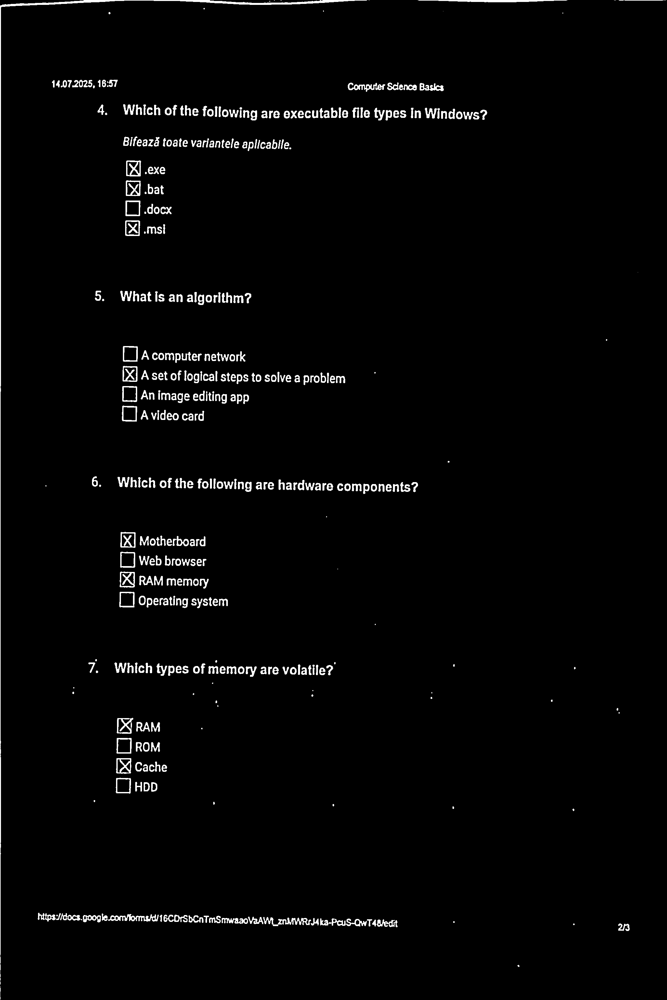

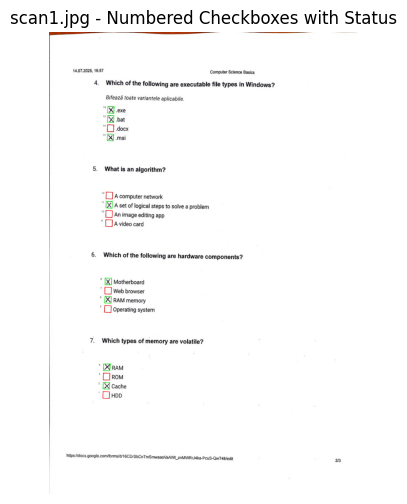

Total of checkboxes: 16


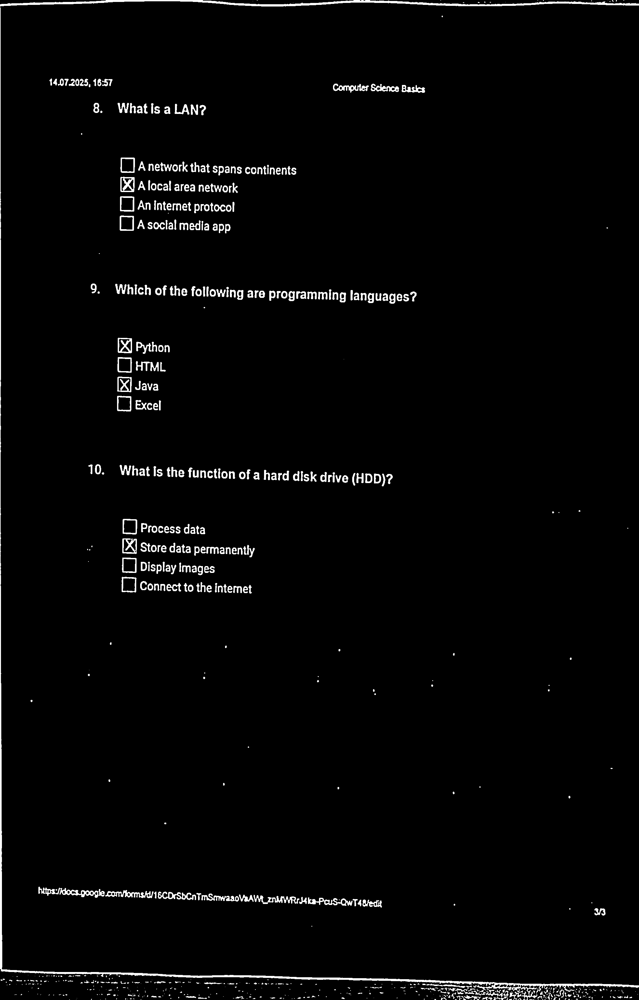

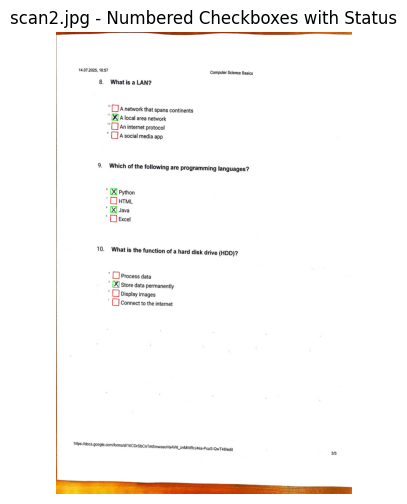

Total of checkboxes: 12


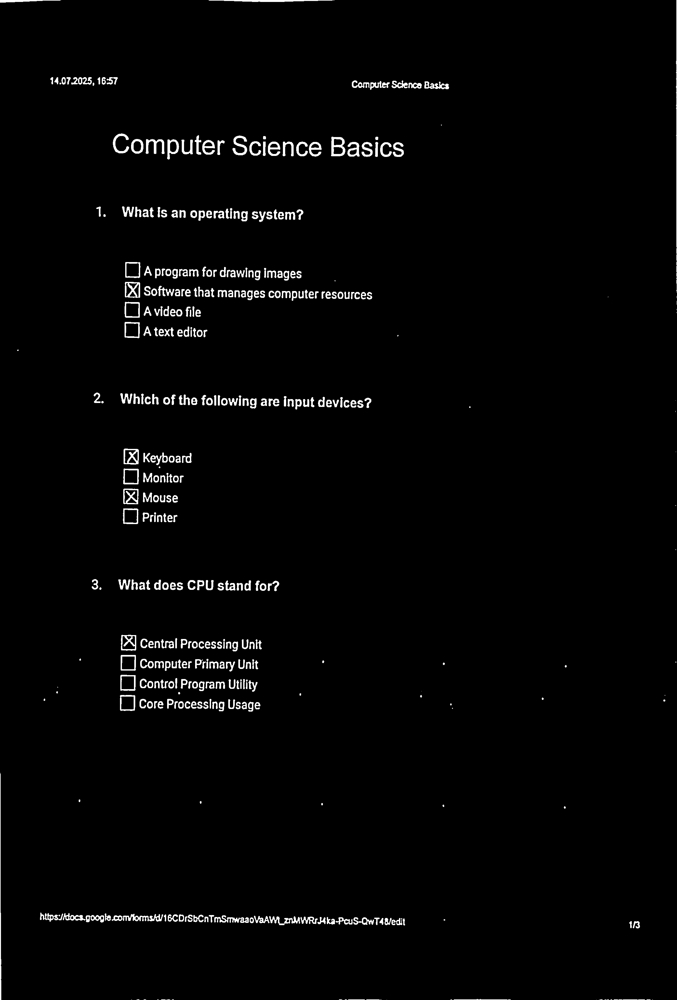

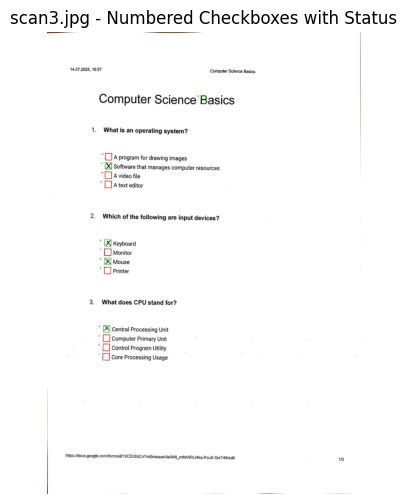

Total of checkboxes: 13


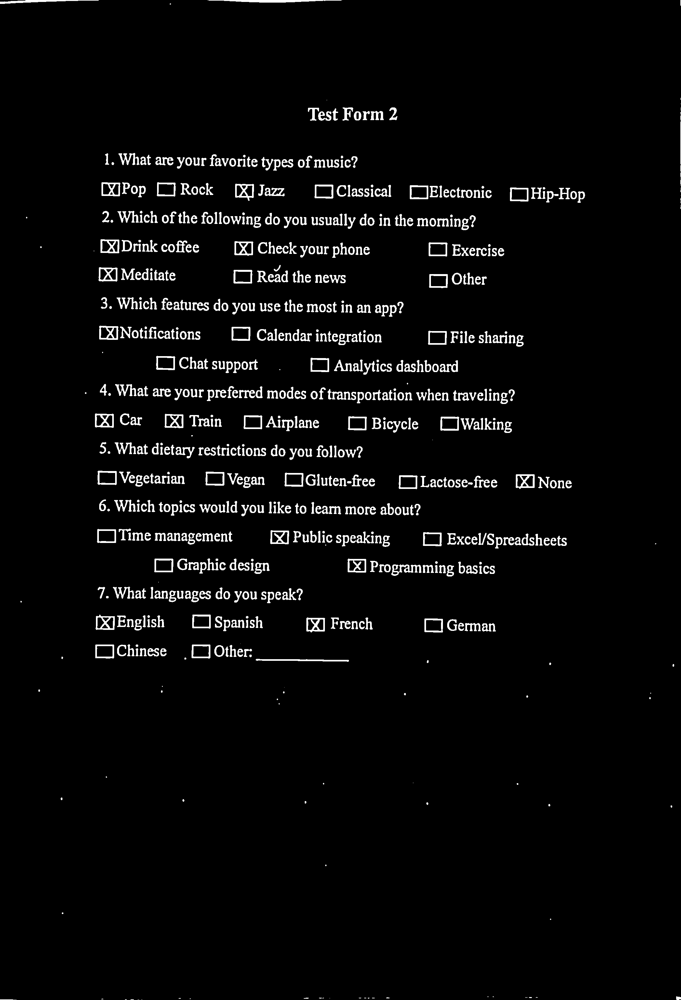

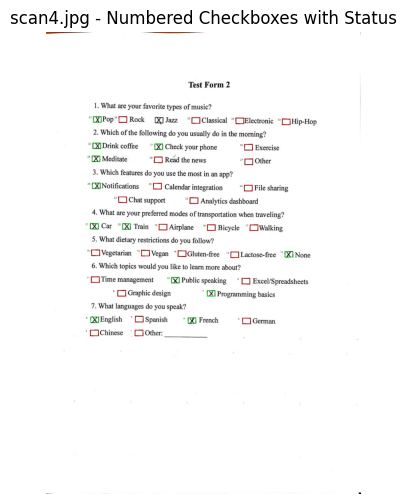

Total of checkboxes: 37


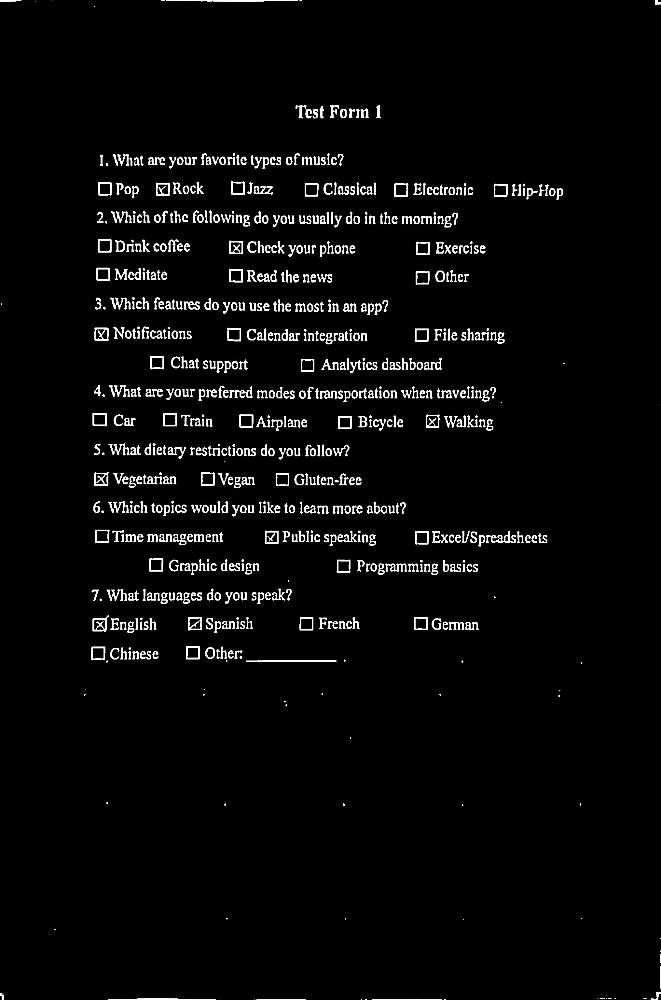

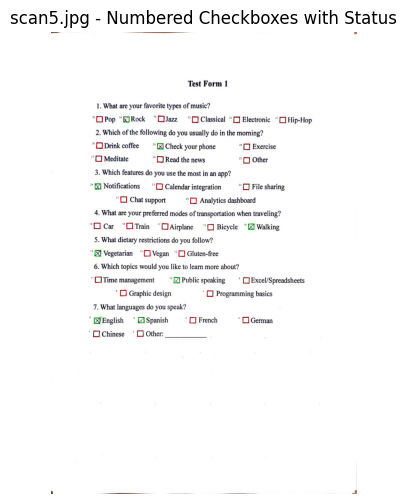

Total of checkboxes: 36


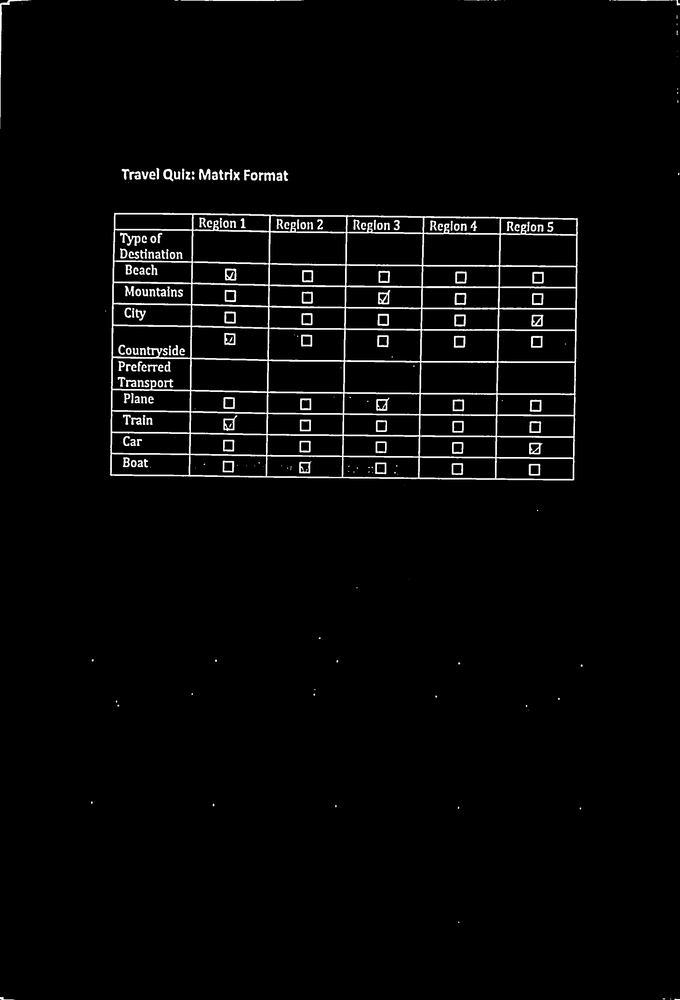

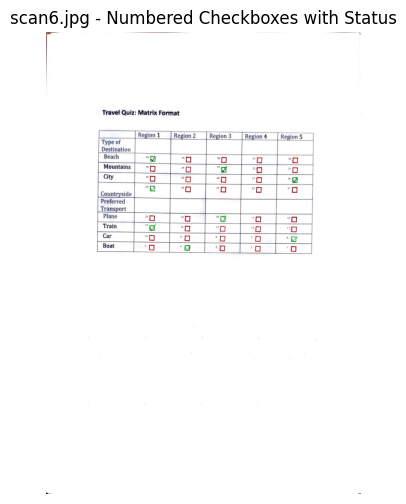

Total of checkboxes: 40


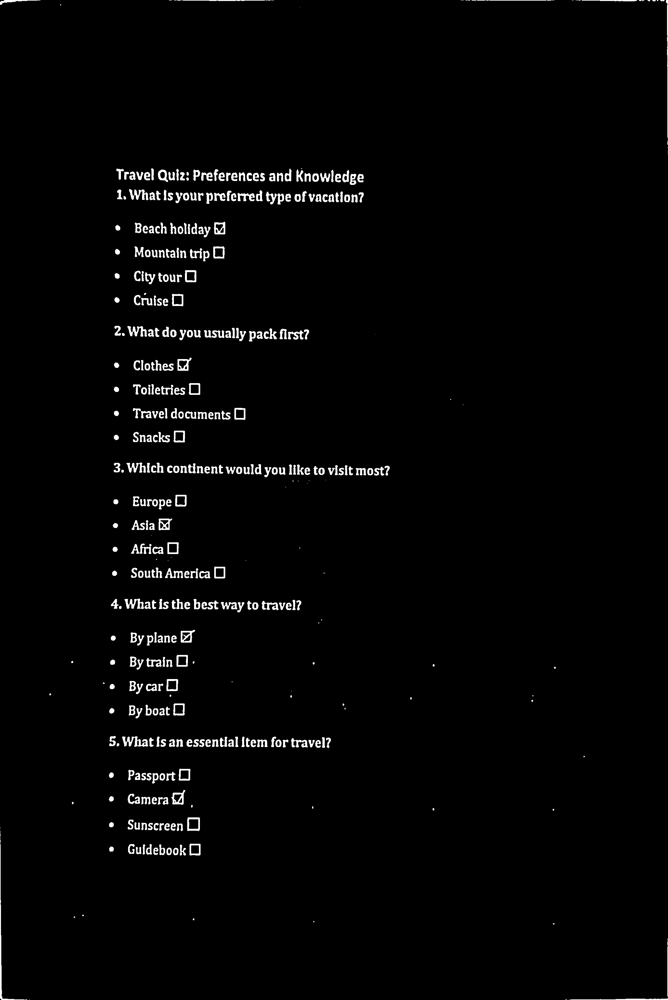

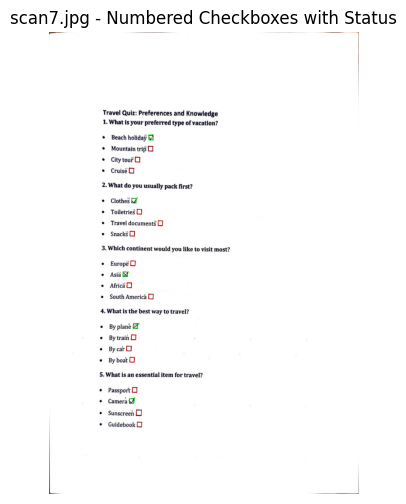

Total of checkboxes: 20


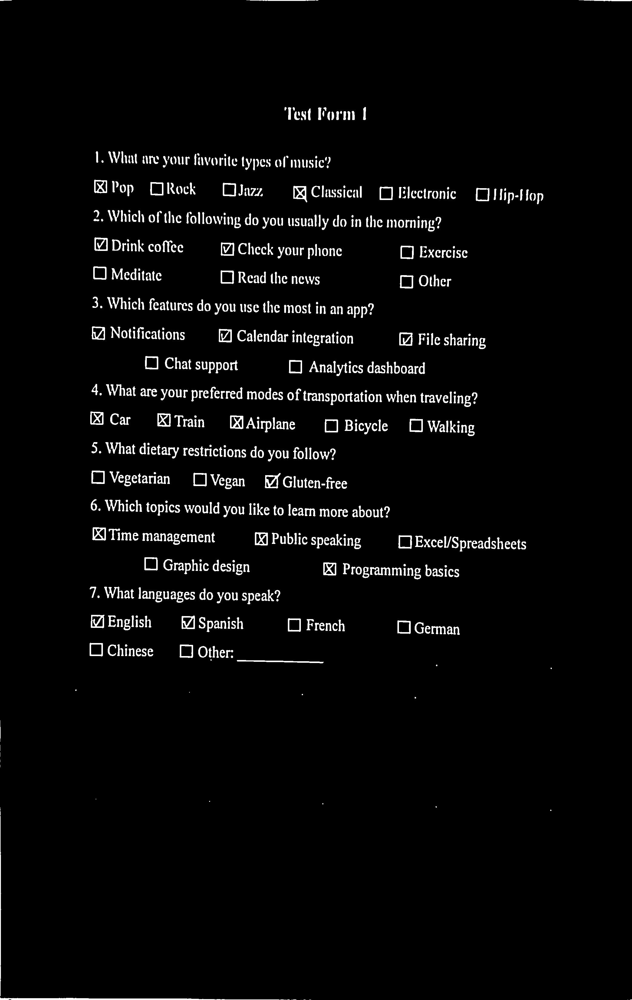

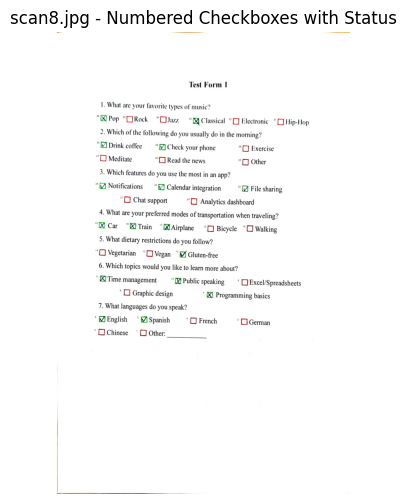

Total of checkboxes: 36


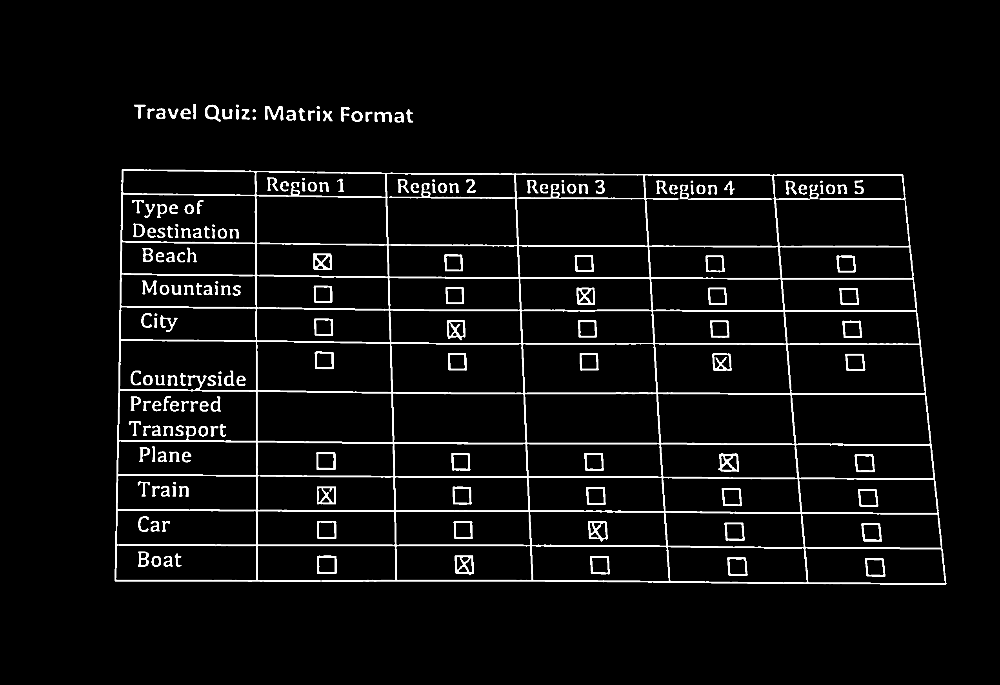

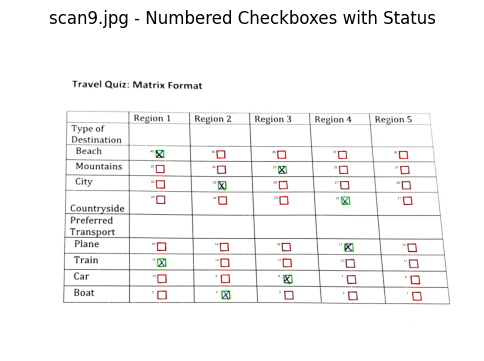

Total of checkboxes: 40


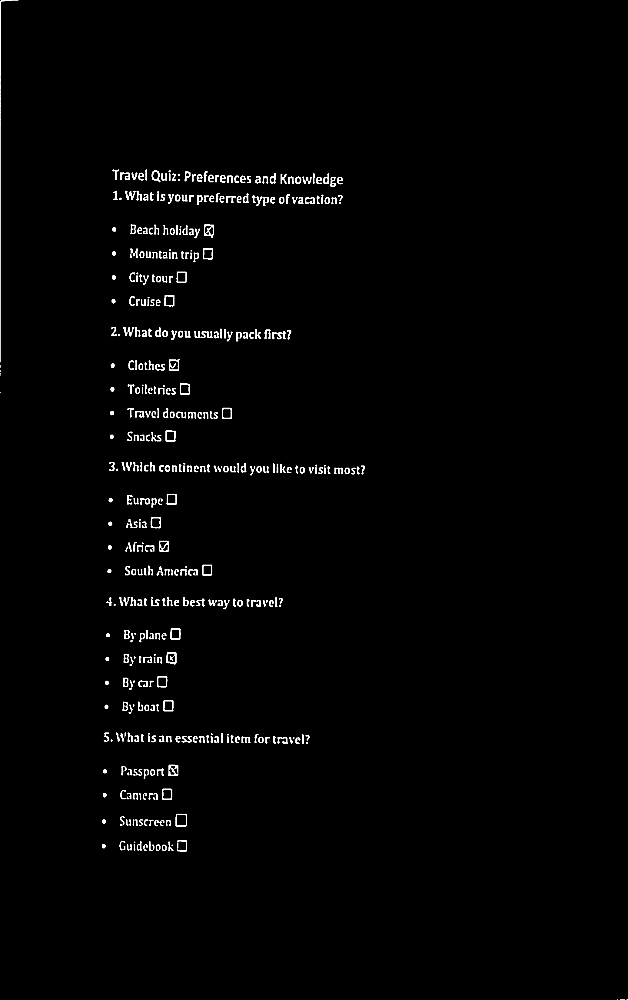

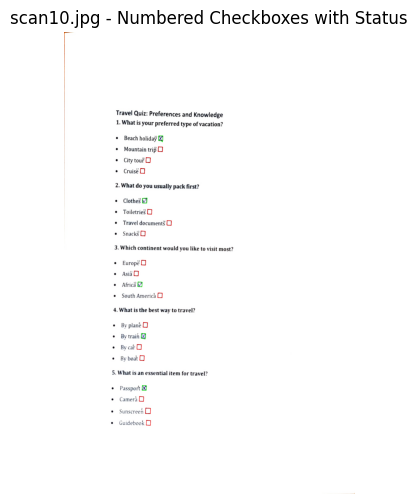

Total of checkboxes: 20


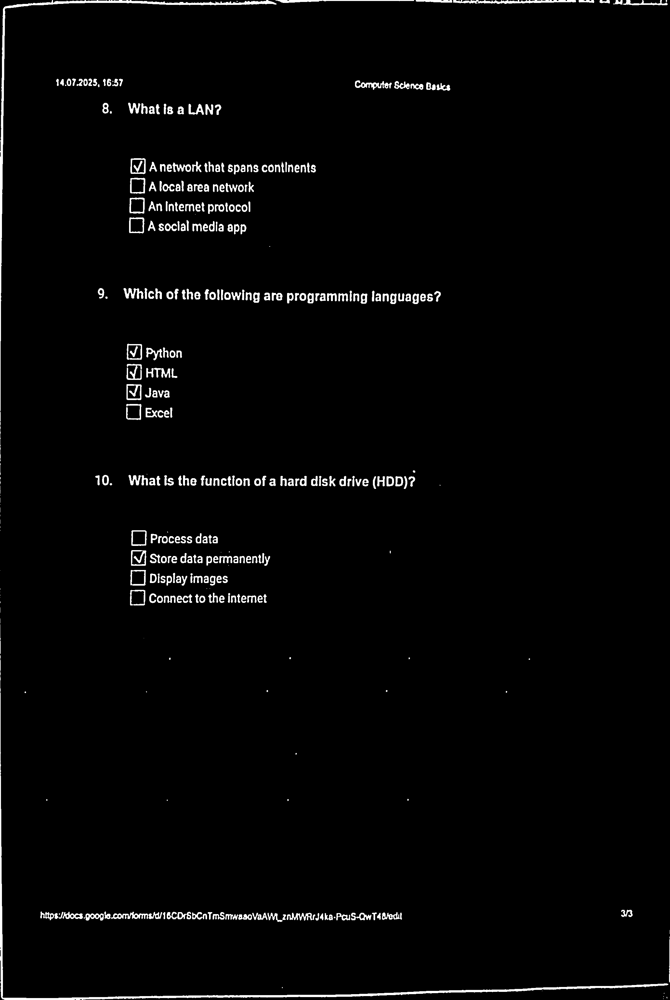

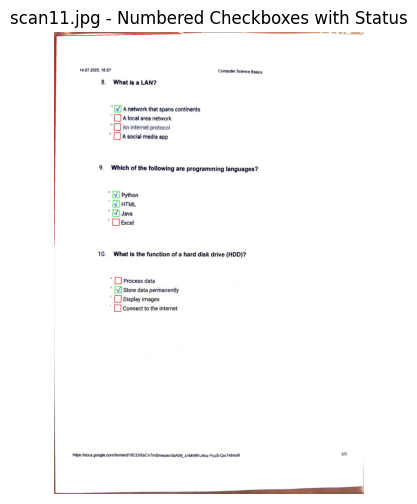

Total of checkboxes: 13


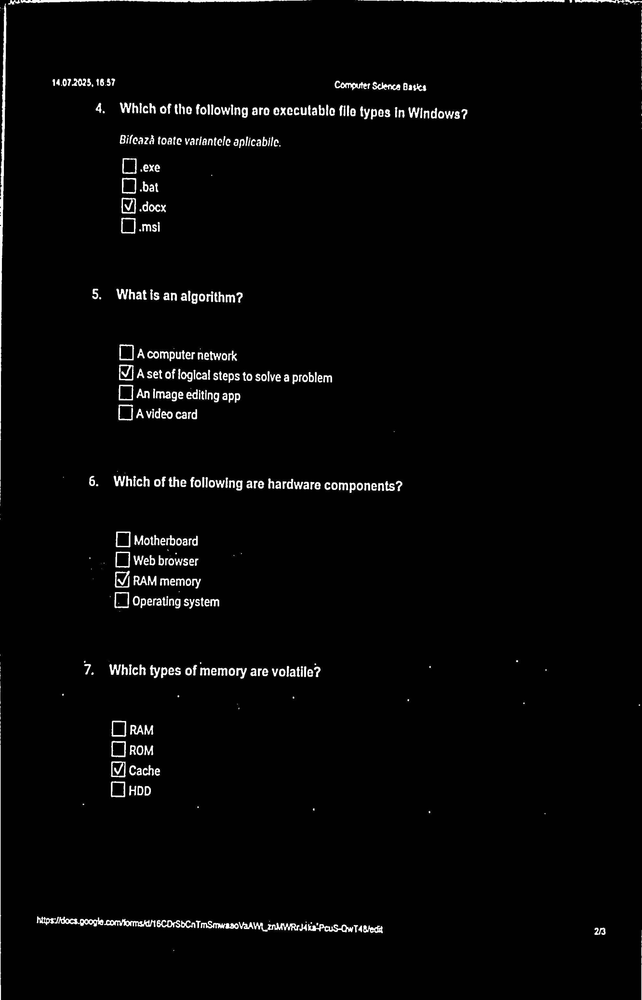

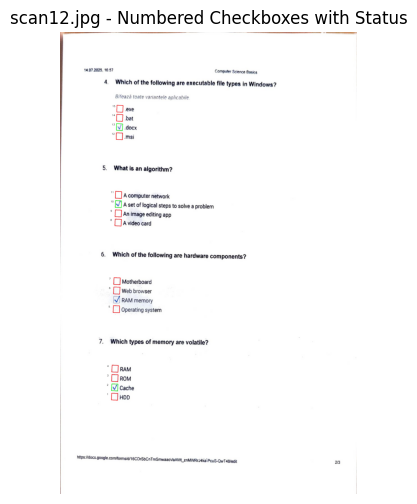

Total of checkboxes: 15


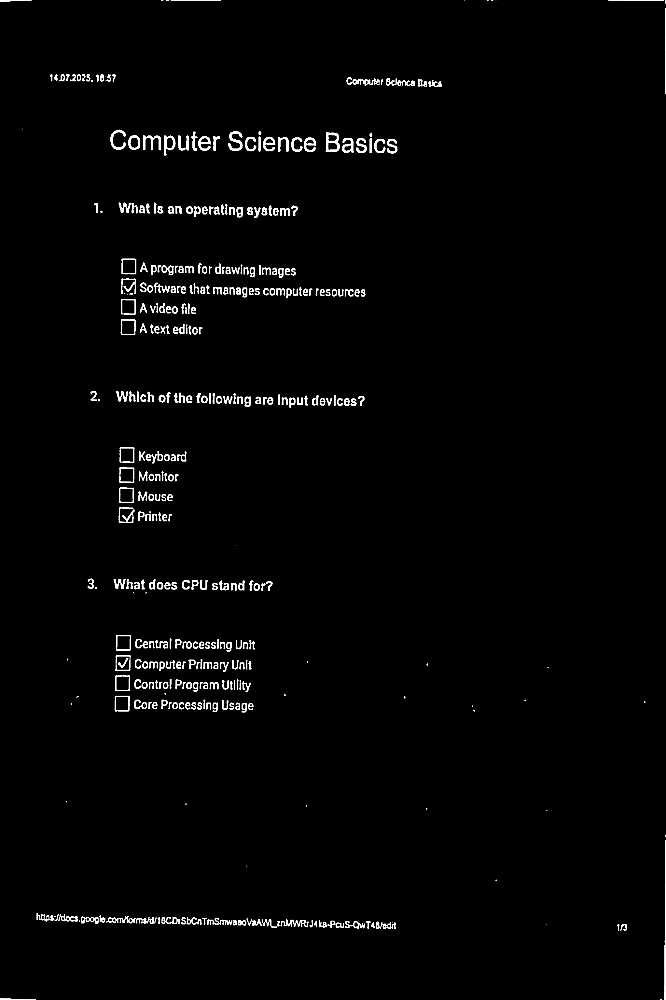

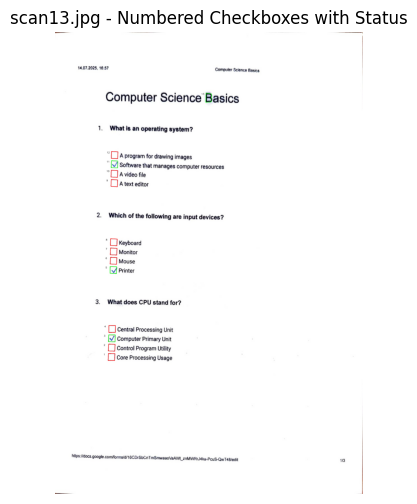

Total of checkboxes: 13


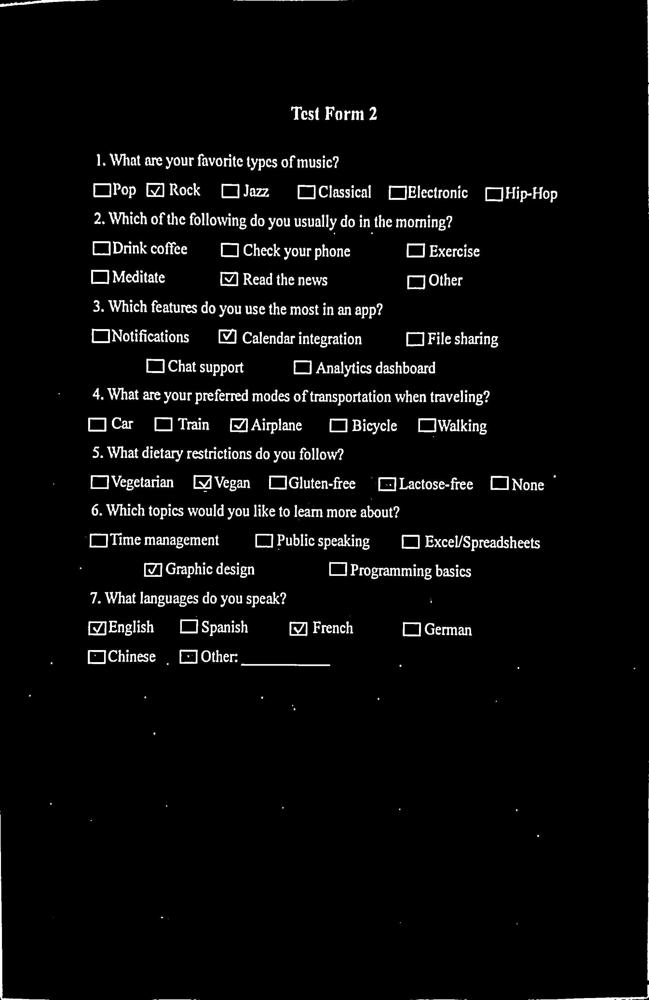

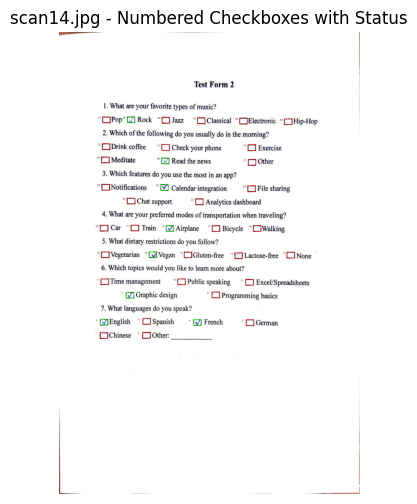

Total of checkboxes: 38


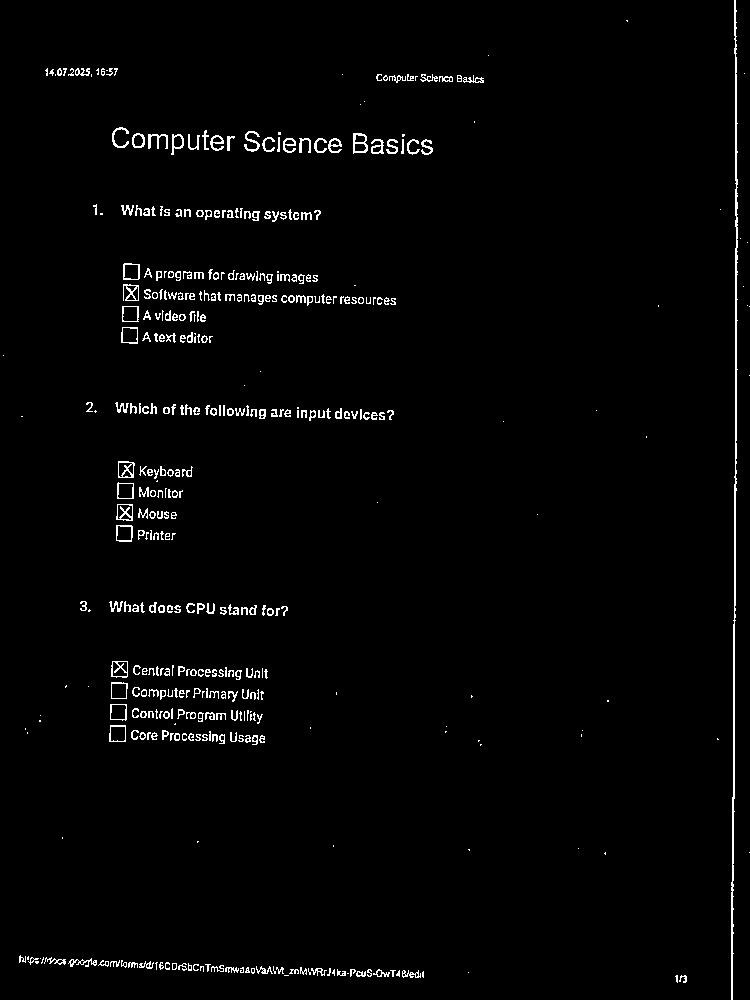

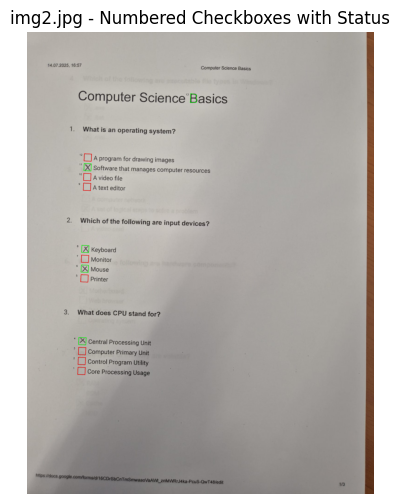

Total of checkboxes: 13


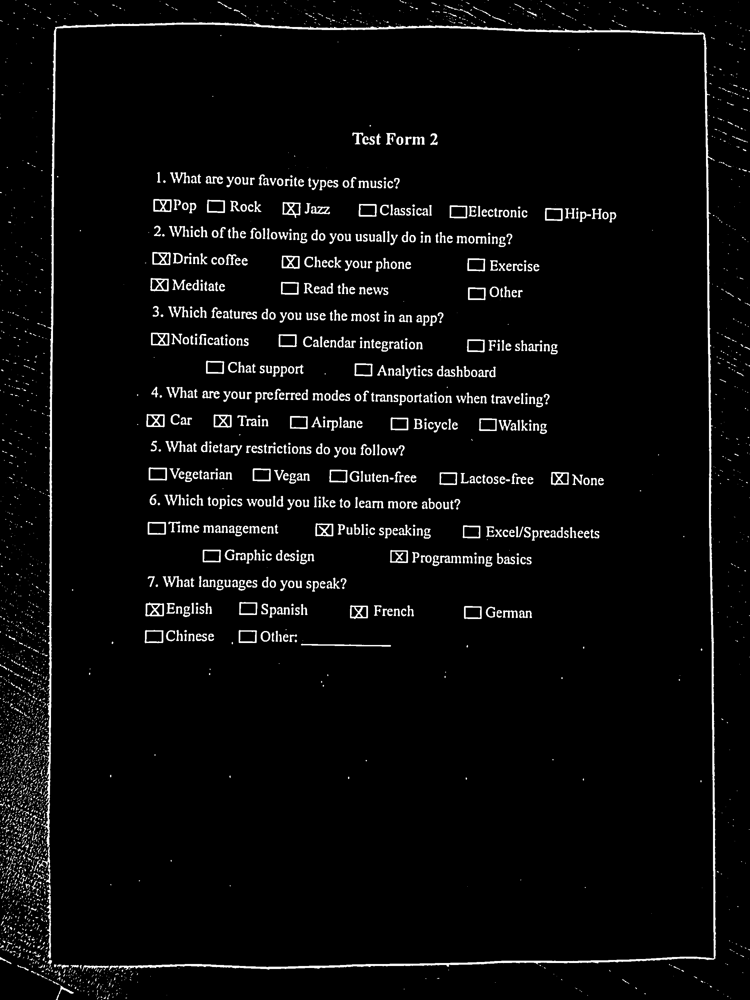

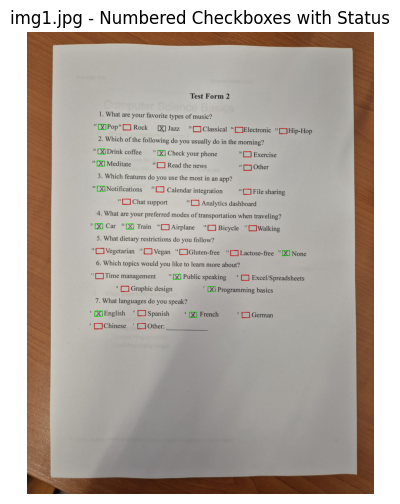

Total of checkboxes: 37


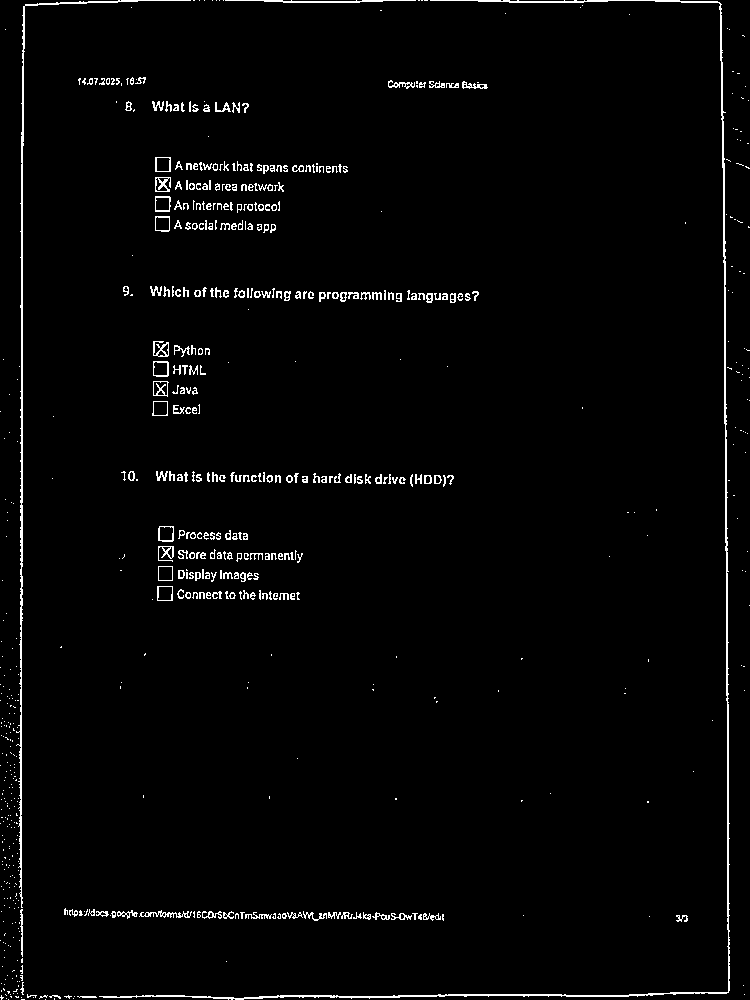

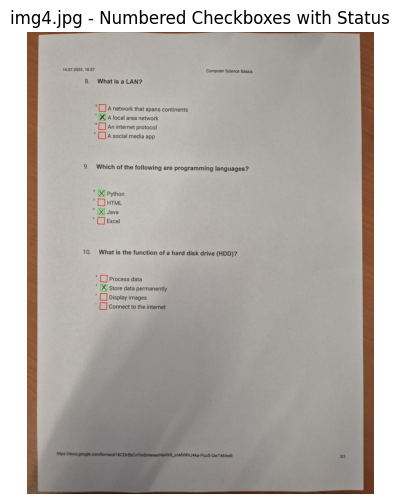

Total of checkboxes: 12


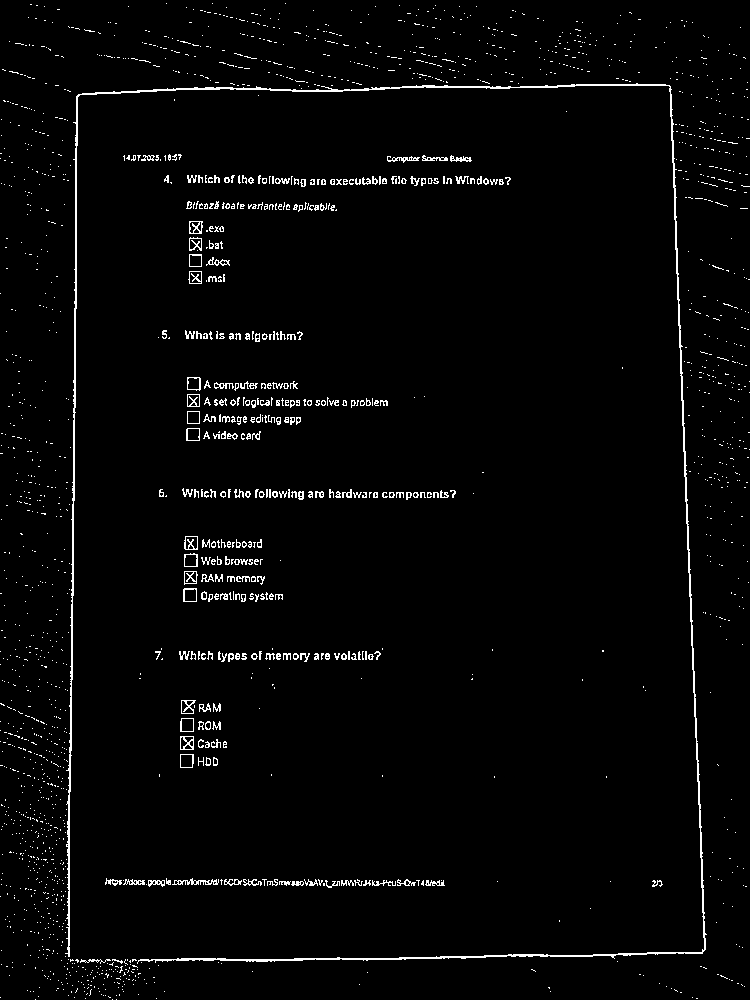

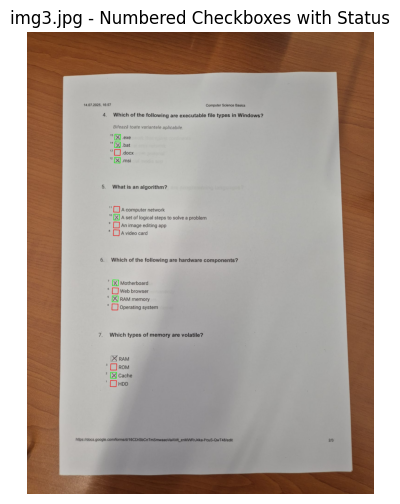

Total of checkboxes: 15


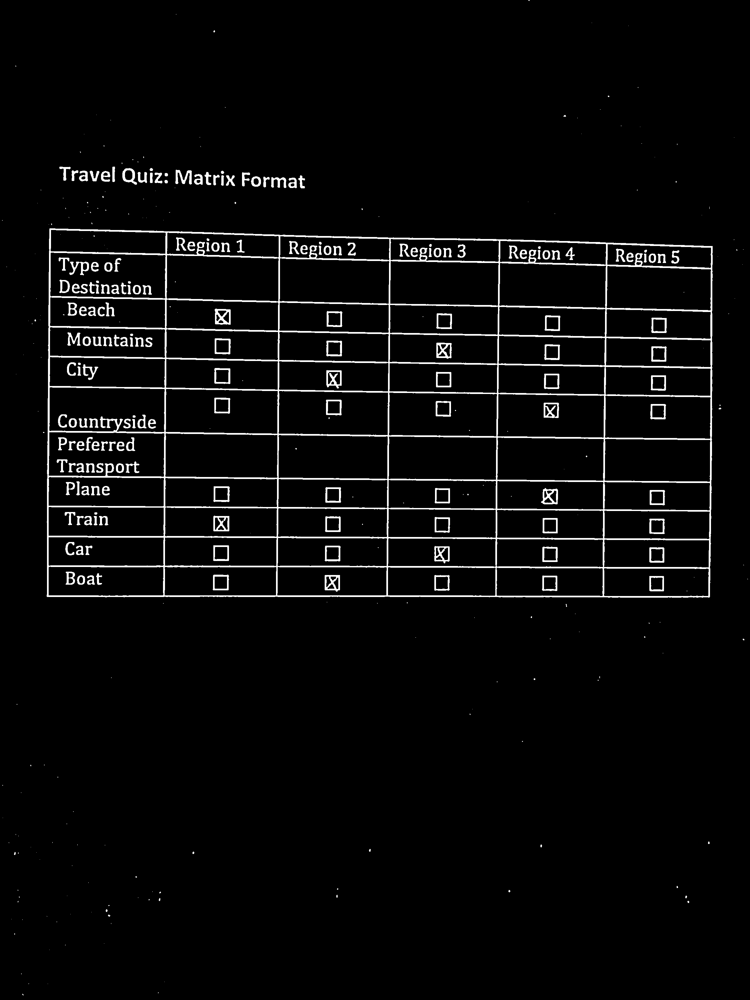

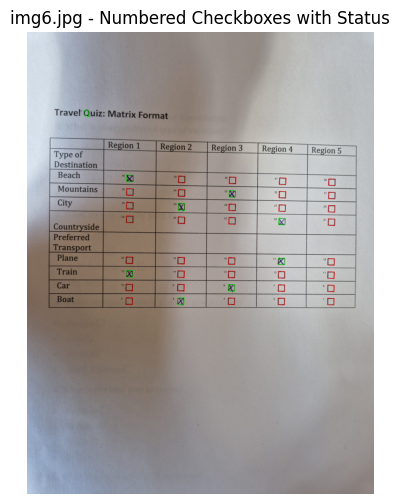

Total of checkboxes: 41


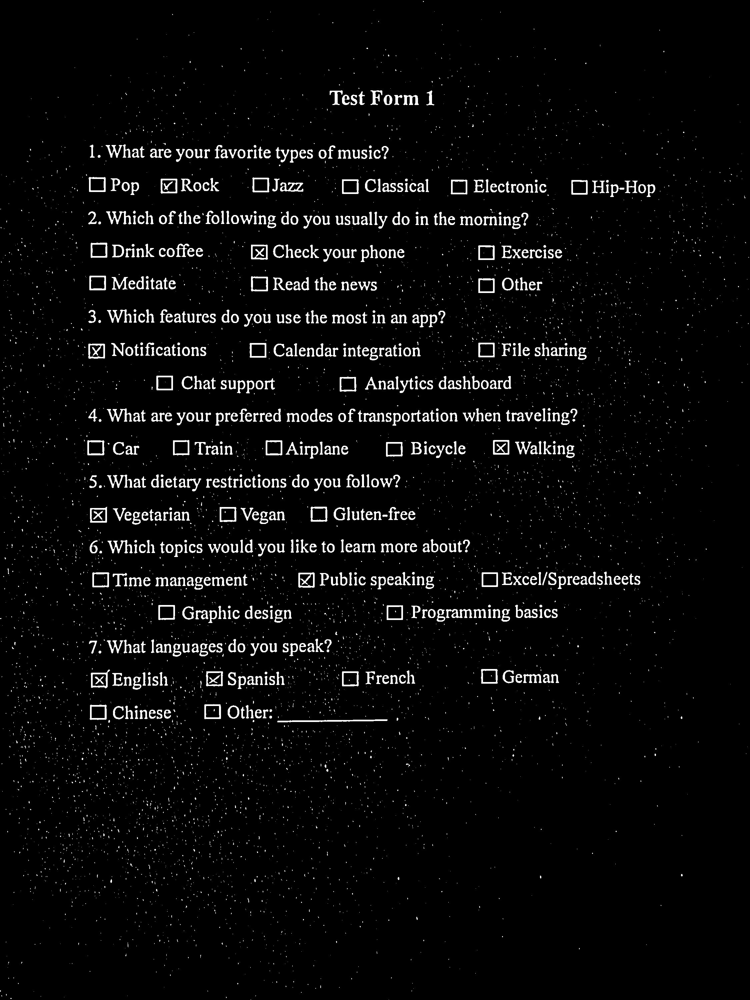

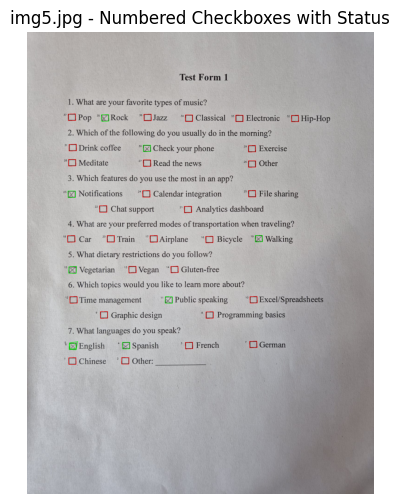

Total of checkboxes: 37


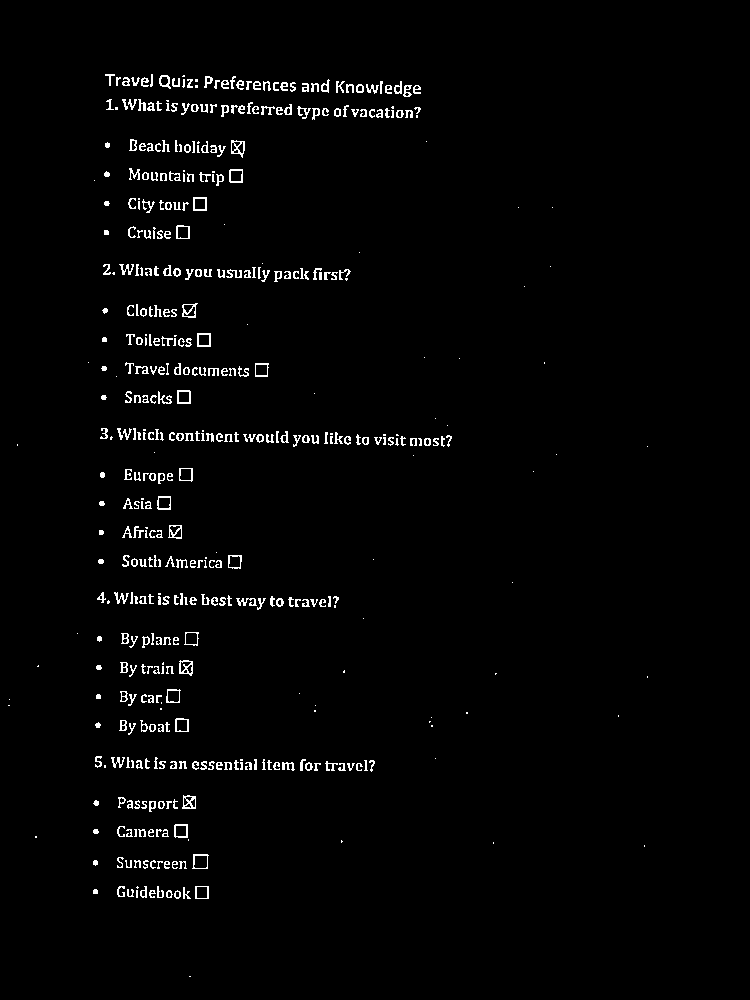

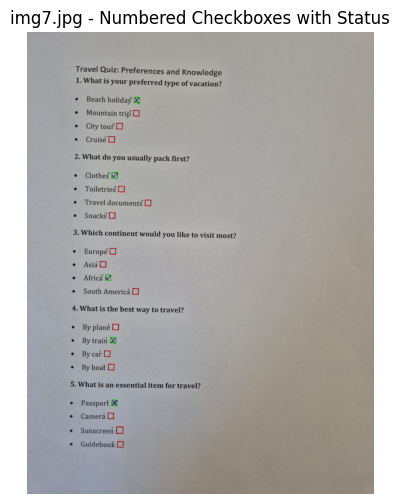

Total of checkboxes: 20


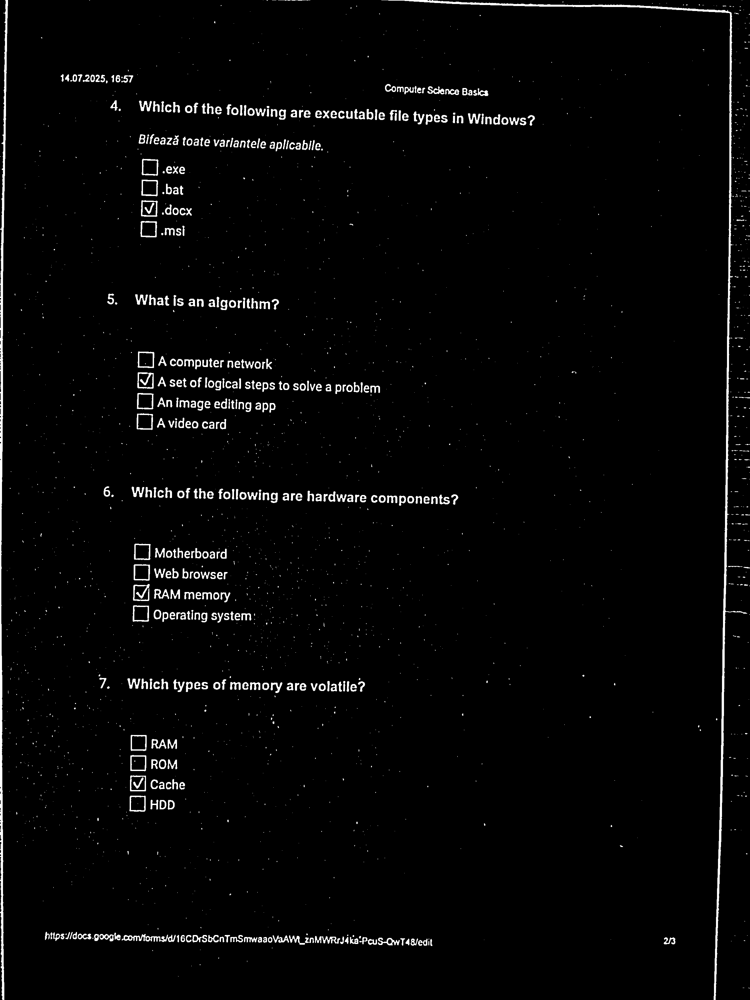

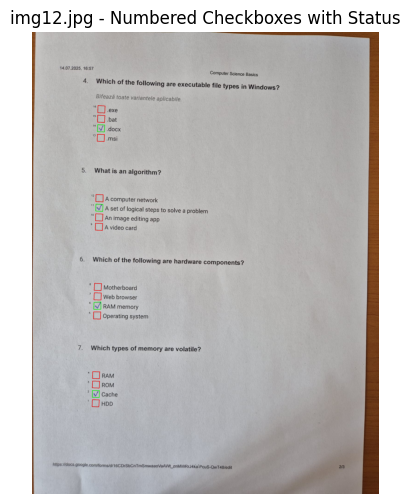

Total of checkboxes: 16


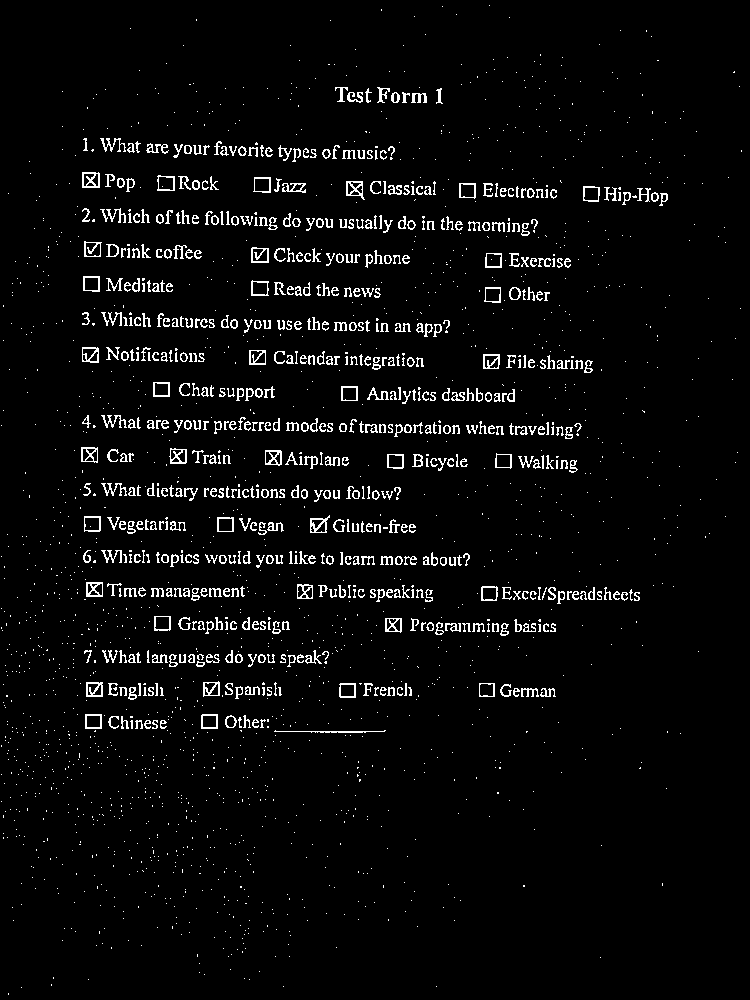

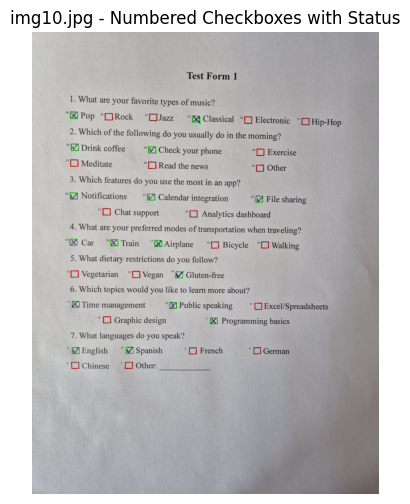

Total of checkboxes: 36


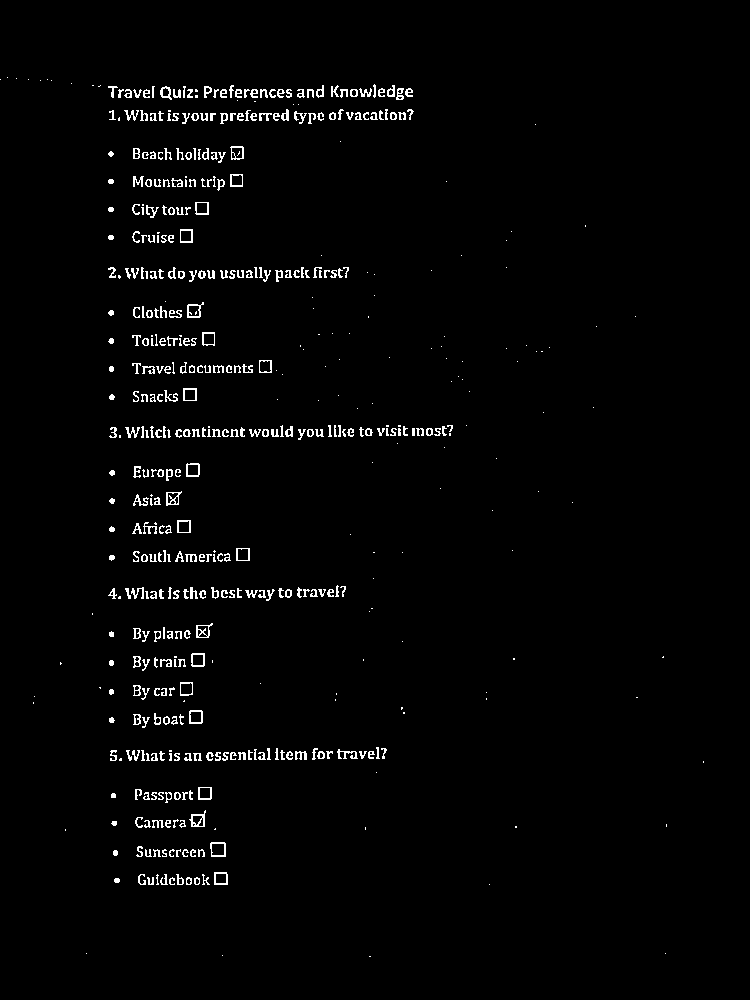

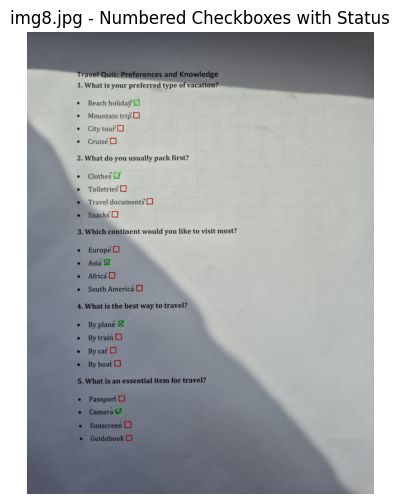

Total of checkboxes: 20


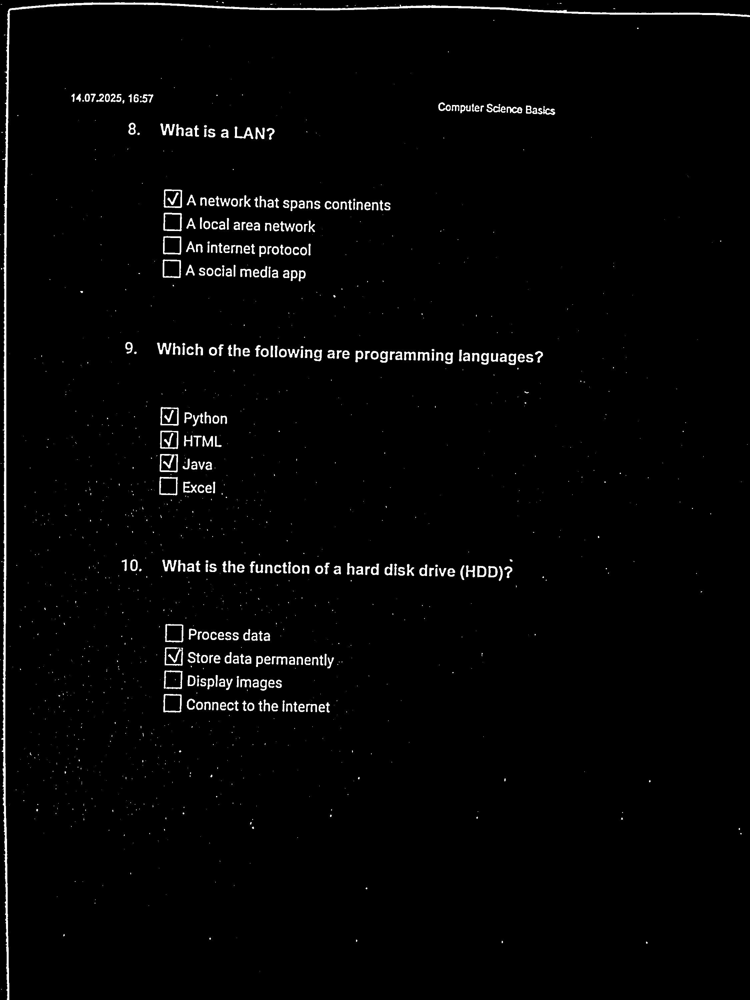

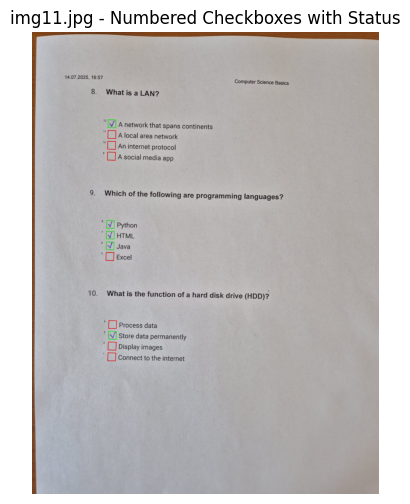

Total of checkboxes: 12


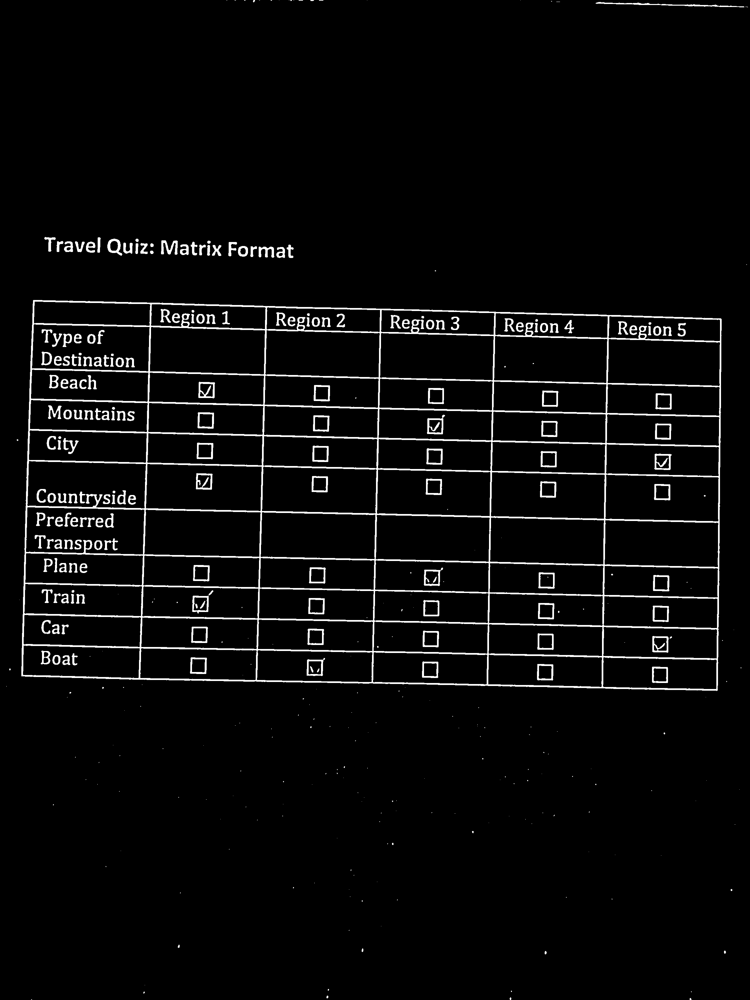

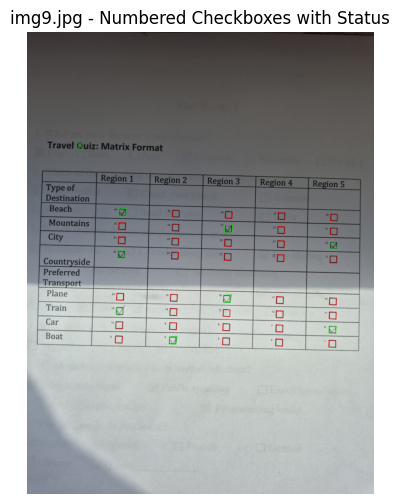

Total of checkboxes: 41


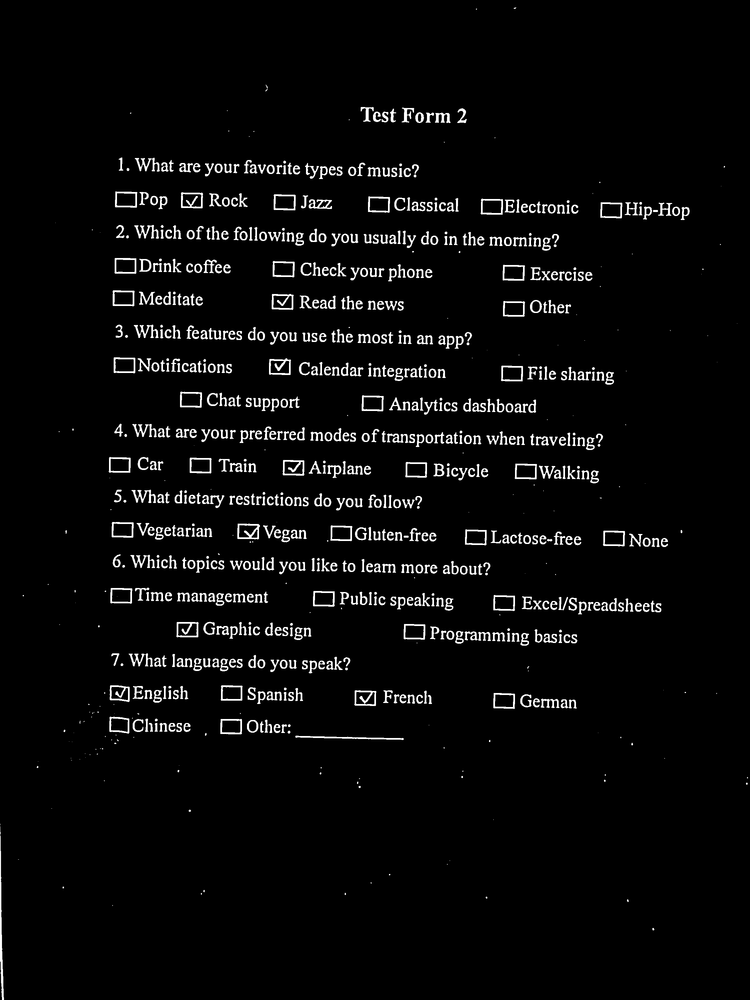

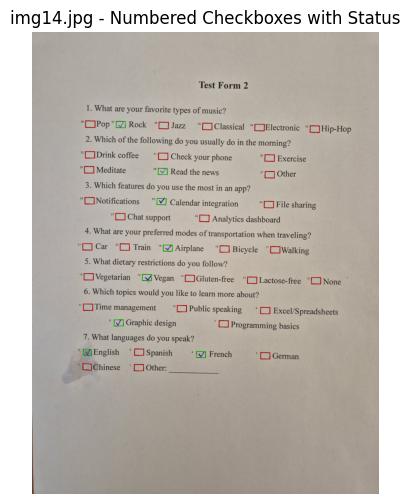

Total of checkboxes: 38


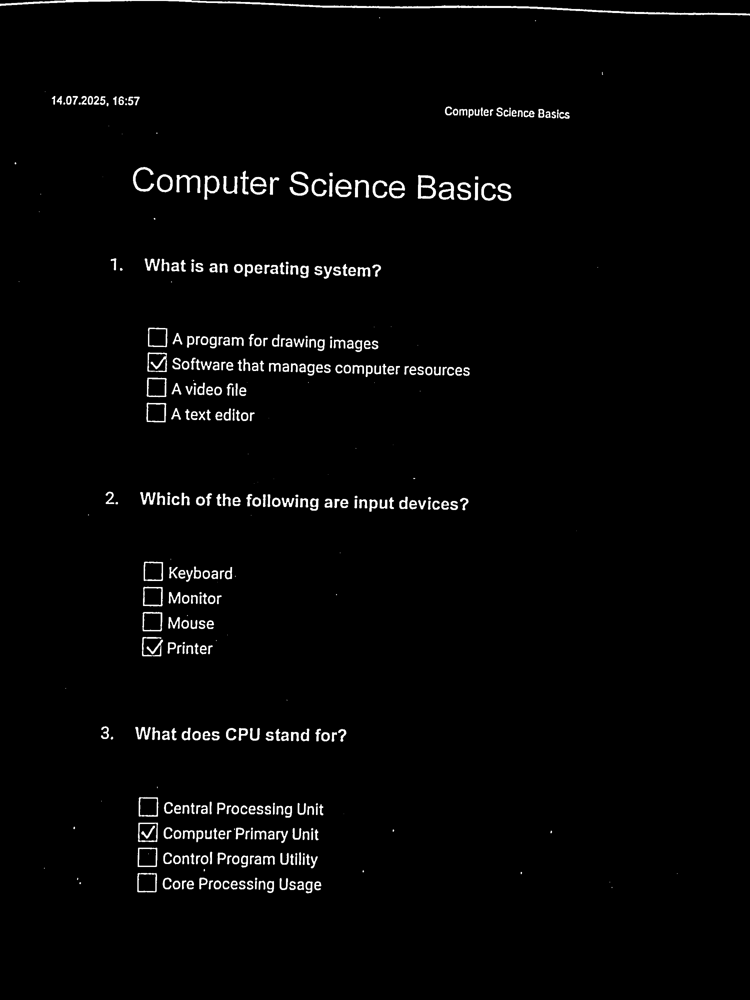

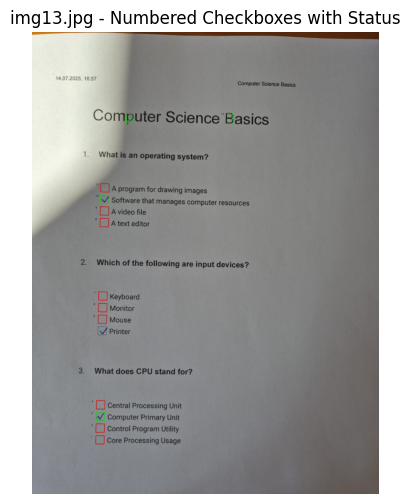

Total of checkboxes: 13


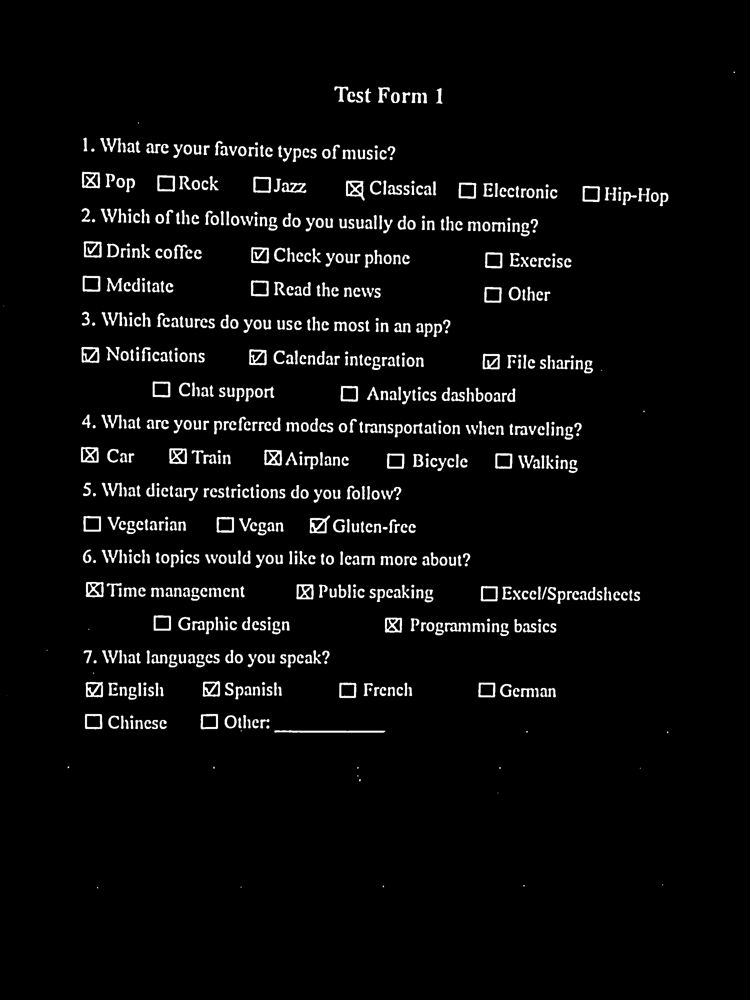

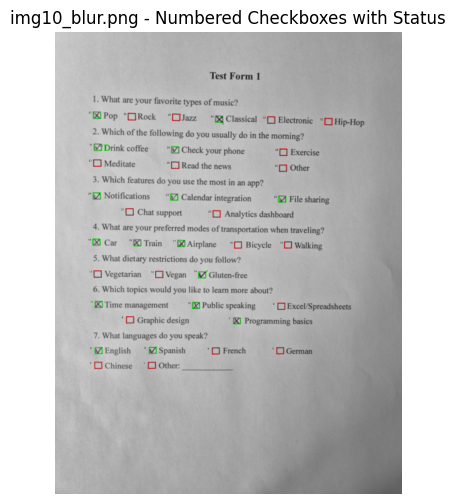

Total of checkboxes: 37


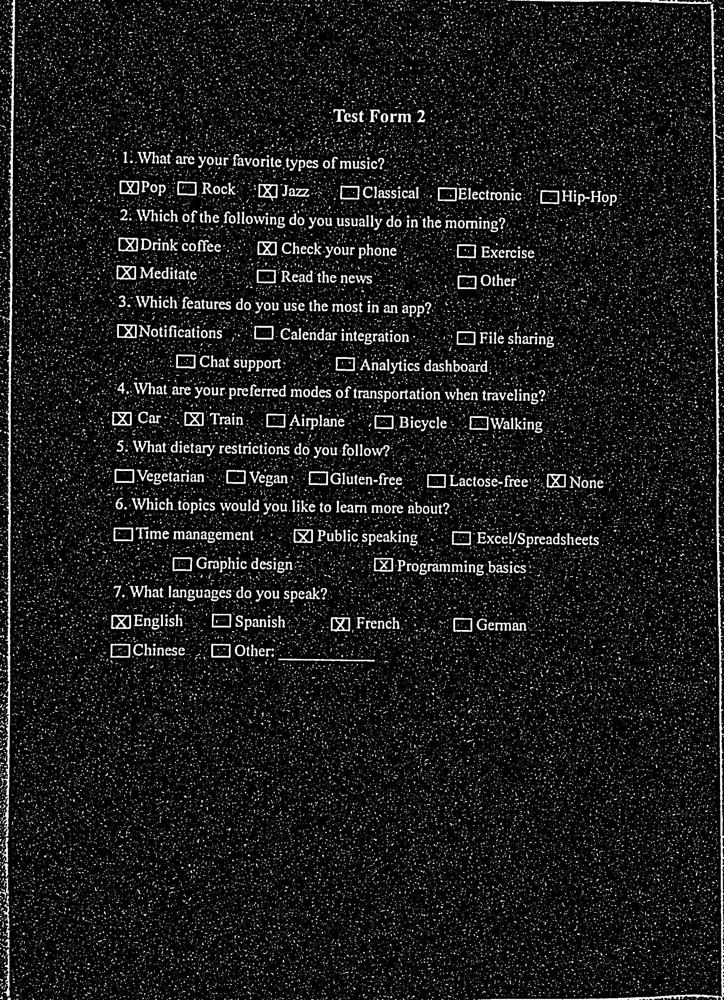

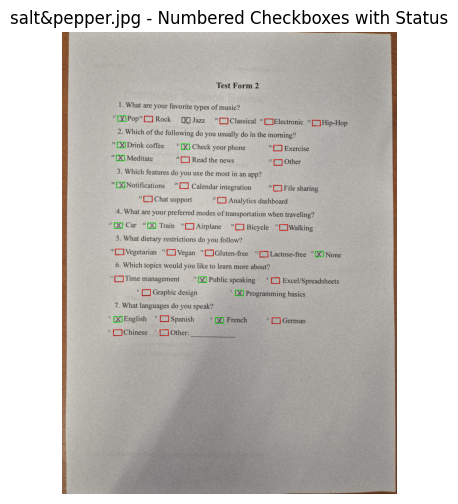

Total of checkboxes: 37


In [ ]:
from google.colab.patches import cv2_imshow

image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

min_area_threshold = 1000
margin = 5

pred_coords = []

def is_close_to_existing_contour(new_contour, valid_boxes, threshold=10):
    new_x, new_y, new_w, new_h = cv2.boundingRect(new_contour)
    for _, x, y, _, _ in valid_boxes:
        dist = np.sqrt((new_x - x) ** 2 + (new_y - y) ** 2)
        if dist < threshold:
            return True
    return False

for img_name in image_files:
    img_path = os.path.join(folder_path, img_name)
    image = cv2.imread(img_path)
    image = cv2.resize(image, None, fx=1.5, fy=1.5, interpolation=cv2.INTER_LINEAR)

    if image is None:
        print(f"[ERROR] Could not read: {img_name}")
        continue

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    thresh = cv2.adaptiveThreshold(blurred, 255,
                                   cv2.ADAPTIVE_THRESH_MEAN_C,
                                   cv2.THRESH_BINARY_INV,
                                   15, 8)

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))

    morph = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=1)

    contours, _ = cv2.findContours(morph, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    valid_boxes = []

    cv2_imshow(morph)

    for cnt in contours:
        epsilon = 0.03 * cv2.arcLength(cnt, True)
        approx = cv2.approxPolyDP(cnt, epsilon, True)

        if 4 <= len(approx) <= 6:
            area = cv2.contourArea(approx)
            x, y, w, h = cv2.boundingRect(approx)
            aspect_ratio = float(w) / h if h != 0 else 0

            if min_area_threshold < area < 5625 and 0.5 < aspect_ratio < 1.8:
                if not is_close_to_existing_contour(approx, valid_boxes):
                    valid_boxes.append((approx, x, y, w, h))

    output_img = image.copy()

    for idx, (box, x, y, w, h) in enumerate(valid_boxes, 1):
        x_crop, y_crop, w_crop, h_crop = x + margin, y + margin, w - 2 * margin, h - 2 * margin
        checkbox_roi = morph[y_crop:y_crop+h_crop, x_crop:x_crop+w_crop]

        inner_roi = checkbox_roi[2:-2, 2:-2]
        avg_intensity = np.mean(inner_roi)

        threshold_for_checked = 15
        is_checked = avg_intensity > threshold_for_checked

        # Save the top-left corner coordinates of each detected checkbox
        pred_coords.append((x, y))


        checkbox_roi_color = cv2.cvtColor(checkbox_roi, cv2.COLOR_GRAY2BGR)

        if is_checked:
            cv2.drawContours(output_img, [box], -1, (0, 255, 0), 2)
        else:
            cv2.drawContours(output_img, [box], -1, (0, 0, 255), 2)

        status = "Checked" if is_checked else "Unchecked"
        #print(f"Checkbox {idx}: {status} (avg intensity = {avg_intensity:.2f})")

        #cv2_imshow(checkbox_roi_color)

        label = f"{idx}"
        cv2.putText(output_img, label, (x - 30, y + 12), cv2.FONT_HERSHEY_SIMPLEX,
                    0.5, (0, 0, 0), 1, cv2.LINE_AA)

    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"{img_name} - Numbered Checkboxes with Status")
    plt.axis('off')
    plt.show()

    print(f"Total of checkboxes: {idx}")

In [ ]:
# Upload the Ground Truth Coordinates
path_true = "/content/drive/MyDrive/Checkbox_Recognition/dataset_coordinates/coordonate_dataset_fara_litere.csv"
df_true = pd.read_csv(path_true)
true_coords = [tuple(row) for row in df_true[['X', 'Y']].values]

# Settings
folder_path = "/content/drive/MyDrive/Checkbox_Recognition/input"
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Compare the detected coordonates with ground truth
true_positives = 0
matched_true = set()

for px, py in pred_coords:
    for idx, (tx, ty) in enumerate(true_coords):
        if idx in matched_true:
            continue
        if abs(px - tx) <= tolerance and abs(py - ty) <= tolerance:
            true_positives += 1
            matched_true.add(idx)
            break

false_positives = len(pred_coords) - true_positives
false_negatives = len(true_coords) - true_positives
accuracy = true_positives / (true_positives + false_positives + false_negatives)

# Show the results
print("\n=== Evaluate Model ===")
print(f"Accuracy: {accuracy:.2%}")
print(f"True Positives: {true_positives}")
print(f"False Positives: {false_positives}")
print(f"False Negatives: {false_negatives}")



=== Evaluate Model ===
Accuracy: 97.44%
True Positives: 762
False Positives: 12
False Negatives: 8
